In [1]:
cd ..

d:\Maodong\NTT_code_Maodong


In [2]:
from hardware.yokogawa_osa import YokogawaOSA

2024-08-05 19:58:17.771 | INFO     | LoggerClient | procID 1444 | logger.py:__init_logger:148
Logger client started at tcp://127.0.0.1:12345


In [3]:
osa = YokogawaOSA()
osa.connect()

2024-08-05 19:56:40.522 | INFO     | OSA | procID 41472 | device.py:connect:32
OSA connected


1

In [7]:
osa.get_wavelength_center()

'+1.55000000E-006\n'

In [12]:
tt = float('+1.55000000E-006\n')/1e-9

In [22]:
from decimal import Decimal
tt = (Decimal('+1.55000000E-006\n')/Decimal(1e-9)).quantize(Decimal('0.01'))
tt

Decimal('1550.00')

In [20]:
Decimal(data).quantize(Decimal('0.00'))

TypeError: conversion from numpy.ndarray to Decimal is not supported

In [32]:
OSASensitivity(3).value

3

In [33]:
class OSASensitivity:
    _sensitivity_map = {
        0: "NHLD",
        1: "NAUT",
        2: "MID",
        3: "HIGH1",
        4: "HIGH2",
        5: "HIGH3",
        6: "NORMAL",
    }

    _reversed_map = {v: k for k, v in _sensitivity_map.items()}

    def __init__(self, value):
        if isinstance(value, int):
            self._init_with_int(value)
        elif isinstance(value, str):
            self._init_with_str(value)
        else:
            raise TypeError(f"Value must be an integer or a string, not {type(value).__name__}.")

    def _init_with_int(self, value):
        if value in self._sensitivity_map:
            self.value = value
            self.name = self._sensitivity_map[value]
        else:
            raise ValueError(f"Invalid sensitivity value: {value}. Valid values are integers from 0 to 6.")

    def _init_with_str(self, value):
        normalized_value = value.strip().upper()
        if normalized_value.isdigit():  # Check if it's a string representation of an integer
            int_value = int(normalized_value)
            self._init_with_int(int_value)
        elif normalized_value in self._reversed_map:
            self.value = self._reversed_map[normalized_value]
            self.name = normalized_value
        else:
            raise ValueError(
                f"Invalid sensitivity name or value: '{value}'. "
                "Valid names are: " + ", ".join(self._sensitivity_map.values())
            )

    @classmethod
    def get_name(cls, value):
        if value in cls._sensitivity_map:
            return cls._sensitivity_map[value]
        raise ValueError(f"OSA sensitivity should choose from 0 to 6, not {value}.")

    @classmethod
    def get_value(cls, name):
        normalized_name = name.upper()
        if normalized_name in cls._reversed_map:
            return cls._reversed_map[normalized_name]
        raise ValueError(
            f"Invalid sensitivity name: '{name}'. "
            "Valid names are: " + ", ".join(cls._sensitivity_map.values())
        )

# Example usage:
try:
    sensitivity = OSASensitivity(" 0 ")
    print(sensitivity.name)  # Output: NHLD
    print(sensitivity.value)  # Output: 0

    sensitivity = OSASensitivity("HIGH1\n")
    print(sensitivity.name)  # Output: HIGH1
    print(sensitivity.value)  # Output: 3

    sensitivity = OSASensitivity("  2 ")
    print(sensitivity.name)  # Output: MID
    print(sensitivity.value)  # Output: 2

    sensitivity = OSASensitivity("invalid")  # Raises ValueError
except ValueError as e:
    print(e)


NHLD
0
HIGH1
3
MID
2
Invalid sensitivity name or value: 'invalid'. Valid names are: NHLD, NAUT, MID, HIGH1, HIGH2, HIGH3, NORMAL


In [21]:
import numpy as np
from decimal import Decimal

def convert_to_decimal(arr):
    # Vectorize the conversion function to apply it element-wise
    vectorized_decimal = np.vectorize(lambda x: Decimal(str(x)))
    return vectorized_decimal(arr)

# Example usage
# array = np.array([1.234, 5.678, 9.1011])
decimal_array = convert_to_decimal(data)

print(decimal_array)


[[[Decimal('0.29945061110761206') Decimal('0.02226996285432359')
   Decimal('0.9801120452280013') Decimal('0.5108067108750651')
   Decimal('0.773251130049645') Decimal('0.45611625864629457')
   Decimal('0.5507485728690946') Decimal('0.19622298325223553')
   Decimal('0.45769017723091154') Decimal('0.6935125705736951')]
  [Decimal('0.00042603769499116595') Decimal('0.8920514956642751')
   Decimal('0.6535528280111339') Decimal('0.7961671122053724')
   Decimal('0.2612484410552044') Decimal('0.025374376427232392')
   Decimal('0.3651306378963921') Decimal('0.044660457148883115')
   Decimal('0.9503918896819206') Decimal('0.13703390613128852')]
  [Decimal('0.3140790120659189') Decimal('0.2868656923970321')
   Decimal('0.2698028171931097') Decimal('0.8306933168053924')
   Decimal('0.883521455508769') Decimal('0.6963662852009264')
   Decimal('0.32382043726954424') Decimal('0.7217988312143373')
   Decimal('0.7685400198737694') Decimal('0.7339293715063373')]
  [Decimal('0.1796610887285831') Decima

In [31]:
# test large array logging speed
import time
import numpy as np
start = time.time()
# Dummy data
data = np.random.rand(1000, 1000)
osa.info(data.tolist())
print(time.time()-start)

2024-08-05 15:00:27.243 | INFO     | YOKOGAWA AQ6375 | procID 56392 | 1547258010.py:<module>:7
[[0.6410716823424443, 0.6578857137026843, 0.740419409180047, 0.11574526570875476, 0.40454852973299216, 0.553615102469399, 0.7730305044576283, 0.5544258939379998, 0.45424519053598866, 0.24870197983611586, 0.9527706317720959, 0.9027679015612404, 0.32325832557189904, 0.8993609673237172, 0.11266005698073867, 0.4741959626786052, 0.8654752436051126, 0.694201012355695, 0.9251061039008278, 0.862740470557189, 0.8142432023148772, 0.49367206944692077, 0.4407967215610664, 0.6855970843855758, 0.7040004057045729, 0.22795748306178087, 0.5393165208225633, 0.9098908575894352, 0.4113188750930886, 0.7758027008187276, 0.32013304794758757, 0.8118437168756605, 0.38703939988261193, 0.41719087233169827, 0.9057392162489419, 0.33840048080026186, 0.044332499916439616, 0.3345349425529336, 0.2500983879651688, 0.8054692721740109, 0.8603405109170723, 0.4044895588811154, 0.8509388478514667, 0.6547281235176143, 0.43957437153

0.7046318054199219


In [1]:
import numpy as np

array = np.array([[1, 2, 3], [4, 5, 6]])
array_string = array.tobytes()  # Use tobytes instead of tostring
print(array_string)

b'\x01\x00\x00\x00\x02\x00\x00\x00\x03\x00\x00\x00\x04\x00\x00\x00\x05\x00\x00\x00\x06\x00\x00\x00'


In [2]:
data = np.random.rand(1000, 1000)

In [10]:
tt

'[[[0.30,0.02,0.98,0.51,0.77,0.46,0.55,0.20,0.46,0.69],\n  [0.00,0.89,0.65,0.80,0.26,0.03,0.37,0.04,0.95,0.14],\n  [0.31,0.29,0.27,0.83,0.88,0.70,0.32,0.72,0.77,0.73],\n  [0.18,0.19,0.46,0.83,0.15,0.40,0.49,0.64,0.93,0.93],\n  [0.23,0.57,0.33,0.38,0.95,0.42,0.29,0.68,0.22,0.38],\n  [0.27,0.68,0.48,0.24,0.06,0.27,0.31,0.62,0.41,0.25],\n  [0.76,0.95,0.92,0.39,0.26,0.31,0.28,0.70,0.10,0.58],\n  [0.92,0.80,0.13,0.69,0.53,0.00,0.40,0.48,0.81,0.04],\n  [0.81,0.66,0.74,0.07,0.18,0.09,0.27,0.60,0.67,0.13],\n  [0.70,0.98,0.71,0.00,0.31,0.08,0.34,0.81,0.50,0.70]],\n\n [[0.94,0.27,0.25,0.43,0.35,0.48,0.00,0.09,0.30,0.34],\n  [0.15,0.84,0.59,0.44,0.65,0.13,0.62,0.02,0.10,0.37],\n  [0.74,0.56,0.70,0.99,0.02,0.79,0.57,0.98,0.50,0.24],\n  [0.39,0.29,0.16,0.20,0.25,0.86,0.43,0.57,0.14,0.38],\n  [0.88,0.51,0.96,0.38,0.04,0.15,0.36,0.43,0.33,0.99],\n  [0.88,0.52,0.04,0.83,0.49,0.39,0.80,0.54,0.43,0.58],\n  [0.70,0.71,0.40,0.31,0.03,0.45,0.06,0.29,0.50,0.55],\n  [0.60,0.58,0.20,0.13,0.83,0.09,0.52,0.01,0

In [9]:
data = np.random.rand(10, 10,10)
tt = np.array2string(data, separator=',', formatter={'float_kind':lambda x: "%.2f" % x}, threshold=np.inf, max_line_width=np.inf)
print(tt)

[[[0.30,0.02,0.98,0.51,0.77,0.46,0.55,0.20,0.46,0.69],
  [0.00,0.89,0.65,0.80,0.26,0.03,0.37,0.04,0.95,0.14],
  [0.31,0.29,0.27,0.83,0.88,0.70,0.32,0.72,0.77,0.73],
  [0.18,0.19,0.46,0.83,0.15,0.40,0.49,0.64,0.93,0.93],
  [0.23,0.57,0.33,0.38,0.95,0.42,0.29,0.68,0.22,0.38],
  [0.27,0.68,0.48,0.24,0.06,0.27,0.31,0.62,0.41,0.25],
  [0.76,0.95,0.92,0.39,0.26,0.31,0.28,0.70,0.10,0.58],
  [0.92,0.80,0.13,0.69,0.53,0.00,0.40,0.48,0.81,0.04],
  [0.81,0.66,0.74,0.07,0.18,0.09,0.27,0.60,0.67,0.13],
  [0.70,0.98,0.71,0.00,0.31,0.08,0.34,0.81,0.50,0.70]],

 [[0.94,0.27,0.25,0.43,0.35,0.48,0.00,0.09,0.30,0.34],
  [0.15,0.84,0.59,0.44,0.65,0.13,0.62,0.02,0.10,0.37],
  [0.74,0.56,0.70,0.99,0.02,0.79,0.57,0.98,0.50,0.24],
  [0.39,0.29,0.16,0.20,0.25,0.86,0.43,0.57,0.14,0.38],
  [0.88,0.51,0.96,0.38,0.04,0.15,0.36,0.43,0.33,0.99],
  [0.88,0.52,0.04,0.83,0.49,0.39,0.80,0.54,0.43,0.58],
  [0.70,0.71,0.40,0.31,0.03,0.45,0.06,0.29,0.50,0.55],
  [0.60,0.58,0.20,0.13,0.83,0.09,0.52,0.01,0.62,0.04],
  [0.22,

In [30]:
data.tobytes()

b'\xa8\x81\x1c\'PE\xb2?j*\x19\x9e7\xee\xe2?\xae\x93\xbb#\xf2\x86\xdd?\xa0uY\x82\'\xb4\x99?\xecn\x94\xbc&\xe0\xda?\x88X>\x8b3\x15\xeb?0\xff\xca\xdf\xf4k\xe6?\n`j\xe6{\x0e\xe7?\\\x84\xd3\xdc\x8f\xc8\xc4?\xbbj!]wn\xe9?x{\xee\x04\xe0\x9c\xec?\xc0\xe2\x0b\xe8\x88\x97\xb1?\x0c\xba\x01\x88\xf7\x04\xc1?\n\xa0\xd8]$\xb5\xd8?\nU\x8b\xd6s|\xe7?\x10\x84w\x03\x83I\xa5?hz\xf1\xa0L\xe9\xe5?ZzE\x82\xcd\xc1\xd0?x\xd3a\tU2\xc5?\xb8f\x892\x84\xda\xd4?Hm8nY;\xe8?\xa6N;\x14Ej\xda?\xe4\xa7j"\xc1m\xe3?\x8675\xc8e\xe3\xd4?Y\n{\xa8\xf45\xe3?S\x0f\xf19l\xda\xe7?\x0c.3\xf7\xc2\xaa\xce?t\x8c\xf6c\x05\xb4\xd5?T(\x18\xd8"\xbb\xd8?\xcb}\x9bc\xe2\x8d\xec?6ap3\x85\xae\xe7?\x98\xf7\xb1\xd7\x18E\xd6?\xaa\x7f\xd3-\xaa\xbb\xe2?\xf0\xaa\xff\xfd\xdcJ\xd9?^\xd4x\xb9BP\xe8?Z\xd2\xd6\x85\xff\x86\xd5?\x0c\xa0/h\x85\xf2\xdf?@\x11D*\x10\\\x98?\x98\xab\xd6\xda\x94\xef\xdf?9:\xc8;\xb0\r\xef?B\x8di\xcem\xcd\xe8?\\x\x19\xd3B\xc5\xc9?\xfe\xfd\xb8F\xa9K\xec?\x92\xcf\xa3\xb0\x945\xd9?(\x19\xc4n%a\xd7?\x86\xc8}/\xe5\x1a\xd2?\xdc\xef\xe7t

In [5]:
osa.critical('thisi is a critical message')

2024-08-05 14:26:15.871 | CRITICAL | YOKOGAWA AQ6375 | procID 73540 | 743298953.py:<module>:1
thisi is a critical message
2024-08-05 14:26:17.422 | INFO     | LoggerClient | procID 73540 | logger.py:__send_critical_email:203
Critical warning email sent to ['maodong.gao@ntt-research.com', 'maodonggao@outlook.com', 'gaomaodong@126.com']


Sent email to ['maodong.gao@ntt-research.com', 'maodonggao@outlook.com', 'gaomaodong@126.com'] successfully.
send email FUNCTION CALLED


In [2]:
cd ..

d:\Maodong\NTT_code_Maodong


In [3]:
from hardware.device import InstrExceptionByNTT

2024-08-05 14:35:05.269 | INFO     | LoggerClient | procID 56392 | logger.py:__init_logger:146
Logger client started at tcp://127.0.0.1:12345


In [4]:
raise InstrExceptionByNTT('this is a critical message')

InstrExceptionByNTT: this is a critical message

In [1]:
# get process id
import os
os.getpid()

42796

In [4]:
from hardware.logger import LoggerClient
logger = LoggerClient()
logger.info('test terminal 2')
ii = 0

2024-08-03 01:24:51.972 | INFO     | LoggerClient | procID 42796 | logger.py:__init_logger:178
Logger client started at tcp://127.0.0.1:12345
2024-08-03 01:24:51.978 | INFO     |  | procID 42796 | 1497555275.py:<module>:3
test terminal 2


In [5]:
logger.info(f"test from 2 again whaterver {ii}")
ii += 1

2024-08-03 01:24:55.229 | INFO     |  | procID 42796 | 3062050596.py:<module>:1
test from 2 again whaterver 0


In [6]:
logger.critical(f"test critical warning from 2")

2024-08-03 01:25:01.425 | CRITICAL |  | procID 42796 | 3457707412.py:<module>:1
test critical warning from 2
2024-08-03 01:25:02.838 | INFO     | LoggerClient | procID 42796 | logger.py:__send_critical_email:256
Critical warning email sent to ['maodong.gao@ntt-research.com', 'maodonggao@outlook.com']


Sent email to ['maodong.gao@ntt-research.com', 'maodonggao@outlook.com'] successfully.
send email FUNCTION CALLED


In [3]:
current_time

'2024-08-03 00:44:56'

In [5]:
# get three character current time zone name
import pytz
current_time_zone = datetime.now(pytz.timezone('US/Pacific')).tzname()

In [6]:
current_time_zone

'PDT'

In [7]:
import time
time.strftime('%Z')

'Pacific Daylight Time'

In [8]:
time.ctime()

'Sat Aug  3 00:49:11 2024'

In [1]:
cd ..

d:\Maodong\NTT_code_Maodong


In [2]:
from hardware.yokogawa_osa import YokogawaOSA
osa = YokogawaOSA()
osa.connect()

2024-08-05 19:51:35.500 | INFO     | LoggerClient | procID 80408 | logger.py:__init_logger:146
Logger client started at tcp://127.0.0.1:12345
2024-08-05 19:51:36.167 | INFO     | OSA | procID 80408 | device.py:connect:32
OSA connected


1

In [10]:
osa.sensitivity

'MID'

In [5]:
osa.get_horizontal_unit()

'NM'

In [7]:
osa.set_horizontal_unit('thz')

2024-08-05 19:12:15.020 | INFO     | OSA | procID 55012 | yokogawa_osa.py:set_horizontal_unit:167
OSA: Set horizontal unit to THZ


In [4]:
osa.get_trace('f', plot=False)

2024-08-05 19:52:34.322 | INFO     | OSA | procID 80408 | yokogawa_osa.py:get_XData:266
OSA: Retrieved X data for trace F is:
 [1545.50,1545.52,1545.54,1545.56,1545.58,1545.60,1545.62,1545.64,1545.66,1545.68,1545.70,1545.72,1545.74,1545.76,1545.78,1545.80,1545.82,1545.84,1545.86,1545.88,1545.90,1545.92,1545.94,1545.96,1545.98,1546.00,1546.02,1546.04,1546.06,1546.08,1546.10,1546.12,1546.14,1546.16,1546.18,1546.20,1546.22,1546.24,1546.26,1546.28,1546.30,1546.32,1546.34,1546.36,1546.38,1546.40,1546.42,1546.44,1546.46,1546.48,1546.50,1546.52,1546.54,1546.56,1546.58,1546.60,1546.62,1546.64,1546.66,1546.68,1546.70,1546.72,1546.74,1546.76,1546.78,1546.80,1546.82,1546.84,1546.86,1546.88,1546.90,1546.92,1546.94,1546.96,1546.98,1547.00,1547.02,1547.04,1547.06,1547.08,1547.10,1547.12,1547.14,1547.16,1547.18,1547.20,1547.22,1547.24,1547.26,1547.28,1547.30,1547.32,1547.34,1547.36,1547.38,1547.40,1547.42,1547.44,1547.46,1547.48,1547.50,1547.52,1547.54,1547.56,1547.58,1547.60,1547.62,1547.64,1547.66,

(array([1545.5 , 1545.52, 1545.54, ..., 1590.46, 1590.48, 1590.5 ]),
 array([-64.8156411, -64.4650465, -59.2049152, ..., -26.7752692,
        -22.4851656, -21.3180326]))

In [7]:
osa.wavelength_center_nm=1550

2024-08-05 19:53:19.213 | INFO     | OSA | procID 80408 | yokogawa_osa.py:set_wavelength_center_nm:55
OSA: Set wavelength center to 1550.00 nm


In [8]:
osa.wavelength_center_nm

1549.9999999999998

2024-08-05 19:23:54.342 | INFO     | OSA | procID 74588 | yokogawa_osa.py:set_horizontal_unit:167
OSA: Set horizontal unit to THZ


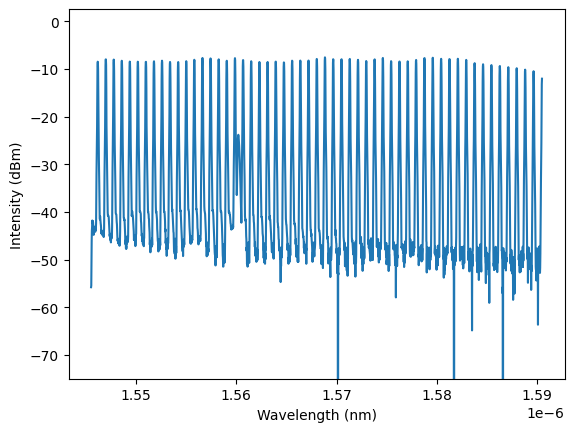

2024-08-05 19:23:55.061 | INFO     | OSA | procID 74588 | yokogawa_osa.py:plot_trace:304
OSA: Trace F data is collected and shown in the plot.


(array([1.54550e-06, 1.54552e-06, 1.54554e-06, ..., 1.59046e-06,
        1.59048e-06, 1.59050e-06]),
 array([-55.8048409, -55.454134 , -50.1938903, ..., -17.5153939,
        -13.2251811, -12.0579389]))

In [3]:
osa.set_horizontal_unit('thz')
osa.get_trace('f')

In [7]:
osa.get_horizontal_unit()

'NM'

In [6]:
osa.set_horizontal_unit('nm')

2024-08-05 19:25:40.963 | INFO     | OSA | procID 74588 | yokogawa_osa.py:set_horizontal_unit:167
OSA: Set horizontal unit to NM


In [9]:
osa.save_trace('f', 'test_trace.npy')

2024-08-05 19:27:52.081 | INFO     | OSA | procID 74588 | yokogawa_osa.py:_save_as_npy:418
OSA: Trace data is saved to test_trace.npy


In [11]:
# loada npy file
import numpy as np
data = np.load('test_trace.npy', allow_pickle=True)